# Tests with 1D Stochastic Symplectic map

### Library Imports

In [2]:
%matplotlib widget

In [3]:
import numpy as np
from numba import njit
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import scipy.interpolate as interpolate
import scipy.integrate as integrate
from scipy.misc import derivative as derivative
from pynverse import inversefunc
import scipy.optimize as optimize
from uncertainties import ufloat
import itertools
import scipy

import ipywidgets as widgets
from IPython.display import display

# Personal libraries
import symplectic_map as sm
import henon_map as hm
import crank_nicolson_numba.nekhoroshev as nk
import crank_nicolson_numba.generic as cn

# animation
from matplotlib import animation, rc
from IPython.display import HTML

## Noise function setup

In [6]:
def standard_map_noise(n_samples, k, p0=1.0, th0=1.0, normed = True):
    """Make an array of correlated noise
    
    Parameters
    ----------
    n_samples : unsigned int
        number of elements
    k : float
        standard map k parameter
    p0 : float, optional
        p0 starting point, by default 1.0
    th0 : float, optional
        th0 starting point, by default 1.0
    
    Returns
    -------
    ndarray, ndarray
        th and p ndarrays of dimention (n_samples)
    """    
    p = np.empty(n_samples)
    th = np.empty(n_samples)
    p[0] = p0
    th[0] = th0
    for i in range(1, n_samples):
        p[i] = np.mod(p[i - 1] + k * np.sin(th[i - 1]), 2*np.pi)
        th[i] = np.mod(th[i - 1] + p[i], 2 * np.pi)
    noise = (p - np.pi) / np.pi
    if normed:
        noise -= np.average(noise)
        noise /= np.std(noise)
    return th, noise

def make_correlated_noise(n_elements, gamma=0.0):
    """Make an array of correlated noise
    
    Parameters
    ----------
    n_elements : unsigned int
        number of elements
    gamma : float, optional
        correlation coefficient, by default 0.0
    
    Returns
    -------
    ndarray
        the noise array
    """    
    noise = np.random.normal(0.0, 1.0, n_elements)
    if gamma != 0.0:
        for i in range(1, n_elements):
            noise[i] += gamma * noise[i - 1]
    noise -= np.average(noise)
    noise /= np.std(noise)
    return noise

In [7]:
noise=make_correlated_noise(1000, 0.0)

plt.figure()
plt.plot(np.correlate(noise, noise, mode="full"))

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [8]:
epsilon = 0.5
x_star = 6.0
delta = 0.0001
exponent = (2)  # 1 / (2)

n_iterations = 200
barrier_radius = 5.0    # pure x

In [9]:
omega_0 = np.pi * 0.5 * 1
omega_1 = 1.0 * 1
omega_2 = 0.0 * 1

In [10]:
plt.figure()
temp = np.linspace(0, cn.action(barrier_radius, 0), 1000)
plt.plot(temp, np.cos(omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5))
plt.plot(temp, np.sin(omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5))

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [11]:
n_realizations = 600000

# When inspecting map characteristics
n_I_samplings = 3000
I_min = 0
I_max = cn.action(barrier_radius, 0)
skip_prints = 10

### Initial distribution

In [12]:
mean = 3.0
sigma = 3

### Setting up discrete map

In [13]:
I_0 = np.empty((n_realizations,))
for i in range(n_realizations):
    j = np.random.normal(mean, sigma)
    while j < 0:
        j = np.random.normal(mean, sigma)
    I_0[i] = j

#angles = np.random.uniform(0.0, np.pi * 2, size=n_realizations)
angles = np.ones((n_realizations)) * 0.0

x_0 = cn.x_from_I_th(I_0, angles)
p_0 = cn.p_from_I_th(I_0, angles)

#x_0 = np.array([cn.I_norm_sampling_to_x(mean, sigma) for i in range(n_realizations)])
#p_0 = np.zeros(n_realizations)

discrete_engine = sm.symplectic_map.generate_instance(omega_0, omega_1, omega_2, epsilon, x_star, delta, exponent, 0.0, barrier_radius, x_0, p_0)

### Crank-Nicolson engine

In [14]:
I_linspace = np.linspace(I_min, I_max, n_I_samplings)

engine = cn.cn_generic(I_min, I_max, cn.normed_normal_linspace(I_min, I_max, mean, sigma, n_I_samplings), 0.5, lambda I: cn.D_calculator(I, epsilon, x_star, delta, exponent))

data0 = engine.get_data()

#### Animation

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

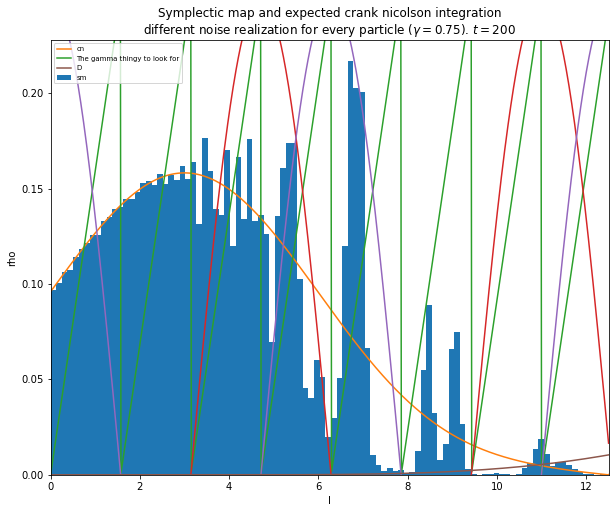

In [29]:
bins=100

discrete_engine.reset()
engine.reset()

gamma = 0.75

steps = 100
iters = n_iterations // steps

pbar = tqdm(total=iters)

fig, ax = plt.subplots(1,1,figsize=(10,8))

noise = make_correlated_noise(n_iterations, 0.9)

def init():
    pass
    
def update(i):
    pbar.update(1)
    engine.iterate(steps)
    discrete_engine.compute_common_noise(noise[i * steps : (i + 1) * steps])    
    ax.clear()
    #ax[1].clear()
    
    data = discrete_engine.get_action()
    
    filtered_data = data[data != 0.0]
    weights = np.empty_like(filtered_data)
    ### USEFUL! ###
    weights.fill((filtered_data.size/data.size) * bins / (filtered_data.max()-filtered_data.min()) / filtered_data.size)
    ###############
    n, _, _ = ax.hist(filtered_data, weights=weights, bins=bins, label="sm")
    ax.plot(I_linspace, engine.get_data(), label="cn")
    ax.set_xlabel("I")
    ax.set_ylabel("rho")
    ax.set_title("Symplectic map and expected crank nicolson integration\ndifferent noise realization for every particle $(\\gamma={})$. $t={}$".format(gamma, (i + 1) * steps))
    ax.set_xlim(( 0, I_max))
    ax.set_ylim(bottom=0.0)
    ax.plot(temp, np.fmod((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)/(np.pi*2), 0.25), label="The gamma thingy to look for")

    ax.plot(temp, np.cos((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)
    ax.plot(temp, np.sin((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)
    
    ax.plot(engine.I, engine.diffusion, label="D")
    ax.legend(fontsize="x-small")
    
    #ax[1].plot(np.real(np.fft.fft(n)))
    #ax[1].plot(np.imag(np.fft.fft(n)))
    

anim = animation.FuncAnimation(fig, update, init_func=init,
                               frames=iters, interval=200)

HTML(anim.to_jshtml())

Animation size has reached 20980654 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


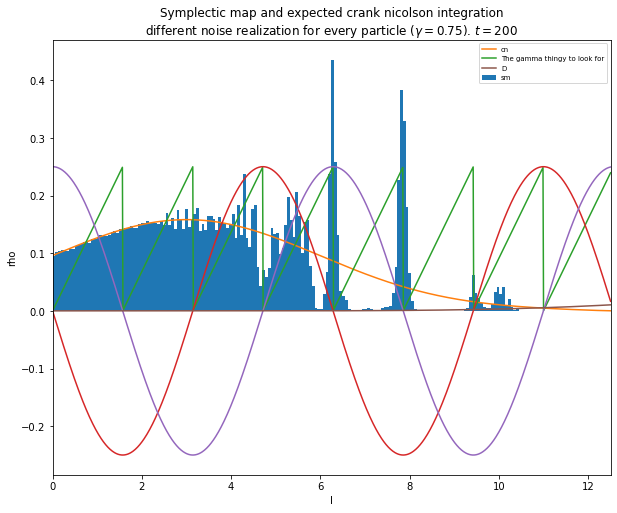

In [121]:
bins=200

discrete_engine.reset()
engine.reset()

gamma = 0.75

steps = 1
iters = n_iterations // steps

pbar = tqdm(total=iters)

fig, ax = plt.subplots(1,1,figsize=(10,8))

noise = make_correlated_noise(n_iterations, 0.9)

def init():
    pass
    
def update(i):
    pbar.update(1)
    engine.iterate(steps)
    discrete_engine.compute_common_noise(noise[i * steps : (i + 1) * steps])    
    ax.clear()
    #ax[1].clear()
    
    data = discrete_engine.get_action()
    
    filtered_data = data[data != 0.0]
    weights = np.empty_like(filtered_data)
    ### USEFUL! ###
    weights.fill((filtered_data.size/data.size) * bins / (filtered_data.max()-filtered_data.min()) / filtered_data.size)
    ###############
    n, _, _ = ax.hist(filtered_data, weights=weights, bins=bins, label="sm")
    ax.plot(I_linspace, engine.get_data(), label="cn")
    ax.set_xlabel("I")
    ax.set_ylabel("rho")
    ax.set_title("Symplectic map and expected crank nicolson integration\ndifferent noise realization for every particle $(\\gamma={})$. $t={}$".format(gamma, (i + 1) * steps))
    ax.set_xlim(( 0, I_max))
    #ax.set_ylim(bottom=0.0)
    ax.plot(temp, np.fmod((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)/(np.pi*2), 0.25), label="The gamma thingy to look for")

    ax.plot(temp, np.cos((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)
    ax.plot(temp, np.sin((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)
    
    ax.plot(engine.I, engine.diffusion, label="D")
    ax.legend(fontsize="x-small")
    
    #ax[1].plot(np.real(np.fft.fft(n)))
    #ax[1].plot(np.imag(np.fft.fft(n)))
    

anim = animation.FuncAnimation(fig, update, init_func=init,
                               frames=iters, interval=200)

HTML(anim.to_jshtml())

NameError: name 'filtered_data' is not defined

#### Individual noise, $\gamma = 0.0$

In [ ]:
discrete_engine.reset()

In [ ]:
discrete_engine.compute_personal_noise(n_iterations, gamma=0.0)

Comparison with Crank-Nicolson (perect matching is observed)

In [ ]:
bins=60
data = discrete_engine.get_action()
filtered_data = data[data != 0.0]
weights = np.empty_like(filtered_data)
### USEFUL! ###
weights.fill((filtered_data.size/data.size) * bins / (filtered_data.max()-filtered_data.min()) / filtered_data.size)
###############

fig2, ax2 = plt.subplots()

ax2.hist(filtered_data, weights=weights, bins=bins, label="sm")
ax2.plot(I_linspace, engine.get_data(), label="cn")
ax2.legend()
ax2.set_xlabel("I")
ax2.set_ylabel("rho")
ax2.set_title("Symplectic map and expected crank nicolson integration\ndifferent noise realization for every particle $(\\gamma=0.0)$")

#### Individual noise, $\gamma=0.5$

In [15]:
discrete_engine.reset()

In [16]:
discrete_engine.compute_personal_noise(int(n_iterations), gamma=0.5)

Comparison with CN data, strong discrepancies are detected! Even though a "general behaviour" can be visualized...

In [17]:
bins=200
data = discrete_engine.get_action()
filtered_data = data[data != 0.0]
weights = np.empty_like(filtered_data)
### USEFUL! ###
weights.fill((filtered_data.size/data.size) * bins / (filtered_data.max()-filtered_data.min()) / filtered_data.size)
###############

fig4, ax4 = plt.subplots()

ax4.hist(filtered_data, weights=weights, bins=bins, label="sm")
ax4.plot(I_linspace, engine.get_data(), label="cn")
ax4.legend()
ax4.set_xlabel("I")
ax4.set_ylabel("rho")
ax4.set_title("Symplectic map and expected crank nicolson integration\ndifferent noise realization for every particle $(\\gamma=0.5)$")
ax4.plot(temp, np.fmod((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)/(np.pi*2), 0.25))
ax4.plot(temp, np.cos((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)
ax4.plot(temp, np.sin((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

#### Individual noise, $\gamma=0.9$

In [21]:
discrete_engine.reset()

In [19]:
discrete_engine.compute_personal_noise(int(n_iterations), gamma=0.90)

In [24]:
noise = make_correlated_noise(int(n_iterations * 2), gamma=0.90)
discrete_engine.compute_common_noise(noise)

Comparison with CN data, strong discrepancies are detected! Even though a "general behaviour" can be visualized...

In [25]:
bins=200
data = discrete_engine.get_action()
filtered_data = data[data != 0.0]
weights = np.empty_like(filtered_data)
### USEFUL! ###
weights.fill((filtered_data.size/data.size) * bins / (filtered_data.max()-filtered_data.min()) / filtered_data.size)
###############

fig4, ax4 = plt.subplots()

ax4.hist(filtered_data, weights=weights, bins=bins, label="sm")
ax4.plot(I_linspace, engine.get_data(), label="cn")
ax4.legend()
ax4.set_xlabel("I")
ax4.set_ylabel("rho")
ax4.set_title("Symplectic map and expected crank nicolson integration\ndifferent noise realization for every particle $(\\gamma=0.90)$")
ax4.plot(temp, np.fmod((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)/(np.pi*2), 0.25))
#ax4.plot(temp, np.cos((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)
#ax4.plot(temp, np.sin((omega_0 + omega_1 * temp + omega_2 * temp * temp * 0.5)) * 0.25)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [73]:
plt.figure()
temp = make_correlated_noise(1000, 1.0)
#_, temp = standard_map_noise(10000, 1.5)
plt.plot(np.real(np.fft.fft(temp)))
#plt.plot(temp)
#plt.plot(np.imag(np.fft.fft(temp)))

/home/carlidel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …